In [1]:
import pandas as pd

In [2]:
pvp = pd.read_csv('final_pvp.csv')
pvp = pvp.drop(columns="Unnamed: 0")

In [3]:
pokedex = pd.read_csv('final_pokedex.csv')
pokedex = pokedex.drop(columns="Unnamed: 0")

In [4]:
pokedex.isna().sum()

ID                0
NAME              0
TYPE_ONE          0
TYPE_TWO        583
BASE_ATTACK       0
BASE_DEFENSE      0
BASE_HP           0
dtype: int64

In [5]:
pokedex.columns

Index(['ID', 'NAME', 'TYPE_ONE', 'TYPE_TWO', 'BASE_ATTACK', 'BASE_DEFENSE',
       'BASE_HP'],
      dtype='object')

In [6]:
pvp.isna().sum()

ID                            0
NAME                          0
TYPE_ONE                      0
TYPE_TWO                   7066
FAST_MOVE                     0
FAST_MOVE_POWER               0
FAST_MOVE_TYPE                0
FAST_ENERGY_BOOST             0
FAST_MOVE_DURATION            0
CHARGE_MOVE                   0
CHARGE_MOVE_POWER             0
CHARGED_MOVE_TYPE             0
CHARGE_MOVE_ENERGY_COST       0
CHARGE_MOVE_DURATION          0
DAMAGE WINDOW START           0
dtype: int64

In [7]:
pvp.columns

Index(['ID', 'NAME', 'TYPE_ONE', 'TYPE_TWO', 'FAST_MOVE', 'FAST_MOVE_POWER',
       'FAST_MOVE_TYPE', 'FAST_ENERGY_BOOST', 'FAST_MOVE_DURATION',
       'CHARGE_MOVE', 'CHARGE_MOVE_POWER', 'CHARGED_MOVE_TYPE',
       'CHARGE_MOVE_ENERGY_COST', 'CHARGE_MOVE_DURATION',
       'DAMAGE WINDOW START'],
      dtype='object')

## ANALYZE DATASETS

In [8]:
from ydata_profiling import ProfileReport

In [9]:
pvp_report = ProfileReport(pvp, title="Player Versus Player Report")

In [10]:
pokdex_report = ProfileReport(pokedex, title="Pokedex Report")

## POKEDEX ANALYSIS

In [11]:
pokdex_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
pokedex.describe()

,ID,BASE_ATTACK,BASE_DEFENSE,BASE_HP
count,1225.000000,1225.000000,1225.000000,1225.000000
mean,381.583673,173.227429,136.687510,170.442449
std,252.182133,61.143074,50.022086,45.457822
min,1.000000,17.000000,31.200000,1.000000
25%,161.000000,126.000000,98.000000,137.000000
50%,356.000000,171.000000,134.000000,163.000000
75%,577.000000,216.000000,170.000000,190.000000
max,1000.000000,414.000000,396.000000,496.000000


## ANALYZE PVP

In [13]:
pvp_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## MERGE DATA

In [14]:
# Assuming 'ID' and 'NAME' are your keys and are formatted consistently
main = pd.merge(pvp, pokedex, on=['ID'], how='left')

In [15]:
main = main.drop(columns=['TYPE_ONE_y','TYPE_TWO_y'])

In [16]:
main = main.rename(columns={"NAME_x":"NAME","TYPE_ONE_x":'TYPE_ONE',"TYPE_TWO_x":'TYPE_TWO'})

## FEATURE ENGINEERING

In [17]:
import numpy as np

# Calculate DPS and EPS
main['FAST_MOVE_DPS'] = main['FAST_MOVE_POWER'] / main['FAST_MOVE_DURATION']
main['CHARGE_MOVE_DPS'] = main['CHARGE_MOVE_POWER'] / main['CHARGE_MOVE_DURATION']
main['FAST_MOVE_EPS'] = main['FAST_ENERGY_BOOST'] / main['FAST_MOVE_DURATION']

# Calculate Synergy Score
main['SYNERGY_SCORE'] = (main['FAST_MOVE_EPS'] * main['CHARGE_MOVE_ENERGY_COST']) / main['CHARGE_MOVE_POWER']

# Type Alignment and STAB
main['TYPE_ALIGNMENT_FAST'] = (main['TYPE_ONE'] == main['FAST_MOVE_TYPE']) | (main['TYPE_TWO'] == main['FAST_MOVE_TYPE'])
main['TYPE_ALIGNMENT_CHARGE'] = (main['TYPE_ONE'] == main['CHARGED_MOVE_TYPE']) | (main['TYPE_TWO'] == main['CHARGED_MOVE_TYPE'])

# Adjusting DPS for STAB
stab_bonus = 1.2  # Typical STAB bonus
main['ADJUSTED_FAST_MOVE_DPS'] = main['FAST_MOVE_DPS'] * np.where(main['TYPE_ALIGNMENT_FAST'], stab_bonus, 1)
main['ADJUSTED_CHARGE_MOVE_DPS'] = main['CHARGE_MOVE_DPS'] * np.where(main['TYPE_ALIGNMENT_CHARGE'], stab_bonus, 1)

In [18]:
main.head(10)

,ID,NAME,TYPE_ONE,TYPE_TWO,FAST_MOVE,FAST_MOVE_POWER,FAST_MOVE_TYPE,FAST_ENERGY_BOOST,FAST_MOVE_DURATION,CHARGE_MOVE,...,BASE_DEFENSE,BASE_HP,FAST_MOVE_DPS,CHARGE_MOVE_DPS,FAST_MOVE_EPS,SYNERGY_SCORE,TYPE_ALIGNMENT_FAST,TYPE_ALIGNMENT_CHARGE,ADJUSTED_FAST_MOVE_DPS,ADJUSTED_CHARGE_MOVE_DPS
0,1,Bulbasaur,Grass,Poison,Tackle,5.0,Normal,5.0,0.5,Return,...,111.0,128.0,10.000000,50.000000,10.0,9.428571,False,False,10.0,50.000000
1,1,Bulbasaur,Grass,Poison,Tackle,5.0,Normal,5.0,0.5,Return,...,88.8,128.0,10.000000,50.000000,10.0,9.428571,False,False,10.0,50.000000
2,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Power Whip,...,111.0,128.0,11.666667,34.615385,10.0,5.555556,True,True,14.0,41.538462
3,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Power Whip,...,88.8,128.0,11.666667,34.615385,10.0,5.555556,True,True,14.0,41.538462
4,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Sludge Bomb,...,111.0,128.0,11.666667,34.782609,10.0,6.250000,True,True,14.0,41.739130
5,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Sludge Bomb,...,88.8,128.0,11.666667,34.782609,10.0,6.250000,True,True,14.0,41.739130
6,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Seed Bomb,...,111.0,128.0,11.666667,26.190476,10.0,6.000000,True,True,14.0,31.428571
7,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Seed Bomb,...,88.8,128.0,11.666667,26.190476,10.0,6.000000,True,True,14.0,31.428571
8,1,Bulbasaur,Grass,Poison,Tackle,5.0,Normal,5.0,0.5,Sludge Bomb,...,111.0,128.0,10.000000,34.782609,10.0,6.250000,False,True,10.0,41.739130
9,1,Bulbasaur,Grass,Poison,Tackle,5.0,Normal,5.0,0.5,Sludge Bomb,...,88.8,128.0,10.000000,34.782609,10.0,6.250000,False,True,10.0,41.739130


In [19]:
main.isna().sum()

ID                              0
NAME                            0
TYPE_ONE                        0
TYPE_TWO                    12334
FAST_MOVE                       0
FAST_MOVE_POWER                 0
FAST_MOVE_TYPE                  0
FAST_ENERGY_BOOST               0
FAST_MOVE_DURATION              0
CHARGE_MOVE                     0
CHARGE_MOVE_POWER               0
CHARGED_MOVE_TYPE               0
CHARGE_MOVE_ENERGY_COST         0
CHARGE_MOVE_DURATION            0
DAMAGE WINDOW START             0
NAME_y                         39
BASE_ATTACK                    39
BASE_DEFENSE                   39
BASE_HP                        39
FAST_MOVE_DPS                   0
CHARGE_MOVE_DPS                 0
FAST_MOVE_EPS                   0
SYNERGY_SCORE                   0
TYPE_ALIGNMENT_FAST             0
TYPE_ALIGNMENT_CHARGE           0
ADJUSTED_FAST_MOVE_DPS          0
ADJUSTED_CHARGE_MOVE_DPS        0
dtype: int64

In [20]:
# Check for NaNs in the original datasets
print(pokedex[['BASE_ATTACK', 'BASE_DEFENSE', 'BASE_HP']].isna().sum())
print(main[['BASE_ATTACK', 'BASE_DEFENSE', 'BASE_HP']].isna().sum())

BASE_ATTACK     0
BASE_DEFENSE    0
BASE_HP         0
dtype: int64
BASE_ATTACK     39
BASE_DEFENSE    39
BASE_HP         39
dtype: int64


In [21]:
# Check for unique identifiers
print(pokedex['ID'].nunique())
print(main['ID'].nunique())
print(pokedex['NAME'].nunique())
print(main['NAME'].nunique())

# Check for any formatting issues
print(pokedex['ID'].apply(lambda x: type(x)).unique())
print(main['ID'].apply(lambda x: type(x)).unique())

839
845
1224
1256
[<class 'int'>]
[<class 'int'>]


In [22]:
# Find rows where any of 'BASE_ATTACK', 'BASE_DEFENSE', or 'BASE_HP' are NaN
nan_rows = main[main[['BASE_ATTACK', 'BASE_DEFENSE', 'BASE_HP']].isna().any(axis=1)]

# Display these rows to understand the context
nan_rows = nan_rows['NAME'].drop_duplicates()

In [23]:
main[main['NAME'] == "Galarian Farfetch'D"]

,ID,NAME,TYPE_ONE,TYPE_TWO,FAST_MOVE,FAST_MOVE_POWER,FAST_MOVE_TYPE,FAST_ENERGY_BOOST,FAST_MOVE_DURATION,CHARGE_MOVE,...,BASE_DEFENSE,BASE_HP,FAST_MOVE_DPS,CHARGE_MOVE_DPS,FAST_MOVE_EPS,SYNERGY_SCORE,TYPE_ALIGNMENT_FAST,TYPE_ALIGNMENT_CHARGE,ADJUSTED_FAST_MOVE_DPS,ADJUSTED_CHARGE_MOVE_DPS
4231,83,Galarian Farfetch'D,Fighting,NaN,Fury Cutter,3.0,Bug,6.0,0.4,Leaf Blade,...,115.0,141.0,7.500000,29.166667,15.000000,7.071429,False,False,7.500000,29.166667
4232,83,Galarian Farfetch'D,Fighting,NaN,Fury Cutter,3.0,Bug,6.0,0.4,Leaf Blade,...,114.0,141.0,7.500000,29.166667,15.000000,7.071429,False,False,7.500000,29.166667
4235,83,Galarian Farfetch'D,Fighting,NaN,Fury Cutter,3.0,Bug,6.0,0.4,Brick Break,...,115.0,141.0,7.500000,25.000000,15.000000,12.375000,False,True,7.500000,30.000000
4236,83,Galarian Farfetch'D,Fighting,NaN,Fury Cutter,3.0,Bug,6.0,0.4,Brick Break,...,114.0,141.0,7.500000,25.000000,15.000000,12.375000,False,True,7.500000,30.000000
4237,83,Galarian Farfetch'D,Fighting,NaN,Rock Smash,15.0,Fighting,10.0,1.3,Leaf Blade,...,115.0,141.0,11.538462,29.166667,7.692308,3.626374,True,False,13.846154,29.166667
4238,83,Galarian Farfetch'D,Fighting,NaN,Rock Smash,15.0,Fighting,10.0,1.3,Leaf Blade,...,114.0,141.0,11.538462,29.166667,7.692308,3.626374,True,False,13.846154,29.166667
4239,83,Galarian Farfetch'D,Fighting,NaN,Fury Cutter,3.0,Bug,6.0,0.4,Brave Bird,...,115.0,141.0,7.500000,65.000000,15.000000,11.538462,False,False,7.500000,65.000000
4240,83,Galarian Farfetch'D,Fighting,NaN,Fury Cutter,3.0,Bug,6.0,0.4,Brave Bird,...,114.0,141.0,7.500000,65.000000,15.000000,11.538462,False,False,7.500000,65.000000
4241,83,Galarian Farfetch'D,Fighting,NaN,Rock Smash,15.0,Fighting,10.0,1.3,Brave Bird,...,115.0,141.0,11.538462,65.000000,7.692308,5.917160,True,False,13.846154,65.000000
4242,83,Galarian Farfetch'D,Fighting,NaN,Rock Smash,15.0,Fighting,10.0,1.3,Brave Bird,...,114.0,141.0,11.538462,65.000000,7.692308,5.917160,True,False,13.846154,65.000000


In [24]:
list(nan_rows)

['Aegislash - Shield',
 'Mudbray',
 'Mudsdale',
 'Chewtle',
 'Sandaconda',
 'Tandemaus']

In [25]:
# List of Pokémon names to be dropped
names_to_drop = ['Aegislash - Shield', 'Mudbray', 'Mudsdale', 'Chewtle', 'Sandaconda', 'Tandemaus']

# Filter the DataFrame to keep only rows where 'NAME' is not in names_to_drop
filtered_df = main[~main['NAME'].isin(names_to_drop)]

# Check the result to ensure the rows are dropped
print(filtered_df['NAME'].value_counts())

NAME
Shadow Ho-Oh               399
Ho-Oh                      399
Mew                        350
Shadow Porygon             266
Porygon                    266
                          ... 
Smeargle                     1
Cosmoem                      1
Cosmog                       1
Gimmighoul Roaming Form      1
Combee                       1
Name: count, Length: 1250, dtype: int64


In [26]:
filtered_df = filtered_df.drop(columns="NAME_y")

In [27]:
filtered_df.isna().sum()

ID                              0
NAME                            0
TYPE_ONE                        0
TYPE_TWO                    12301
FAST_MOVE                       0
FAST_MOVE_POWER                 0
FAST_MOVE_TYPE                  0
FAST_ENERGY_BOOST               0
FAST_MOVE_DURATION              0
CHARGE_MOVE                     0
CHARGE_MOVE_POWER               0
CHARGED_MOVE_TYPE               0
CHARGE_MOVE_ENERGY_COST         0
CHARGE_MOVE_DURATION            0
DAMAGE WINDOW START             0
BASE_ATTACK                     0
BASE_DEFENSE                    0
BASE_HP                         0
FAST_MOVE_DPS                   0
CHARGE_MOVE_DPS                 0
FAST_MOVE_EPS                   0
SYNERGY_SCORE                   0
TYPE_ALIGNMENT_FAST             0
TYPE_ALIGNMENT_CHARGE           0
ADJUSTED_FAST_MOVE_DPS          0
ADJUSTED_CHARGE_MOVE_DPS        0
dtype: int64

In [28]:
# Replace empty strings in 'TYPE_TWO' with 'None'
filtered_df['TYPE_TWO'] = filtered_df['TYPE_TWO'].replace(np.nan,'None')

# Check the update
print(filtered_df['TYPE_TWO'].value_counts())

TYPE_TWO
None        12301
Flying       3574
Ground       1633
Poison       1073
Steel        1044
Psychic       995
Grass         812
Fairy         633
Dark          627
Ice           483
Fighting      476
Rock          426
Water         398
Dragon        355
Ghost         337
Fire          226
Normal        223
Electric      152
Bug           116
Name: count, dtype: int64


In [29]:
filtered_df.isna().sum()

ID                          0
NAME                        0
TYPE_ONE                    0
TYPE_TWO                    0
FAST_MOVE                   0
FAST_MOVE_POWER             0
FAST_MOVE_TYPE              0
FAST_ENERGY_BOOST           0
FAST_MOVE_DURATION          0
CHARGE_MOVE                 0
CHARGE_MOVE_POWER           0
CHARGED_MOVE_TYPE           0
CHARGE_MOVE_ENERGY_COST     0
CHARGE_MOVE_DURATION        0
DAMAGE WINDOW START         0
BASE_ATTACK                 0
BASE_DEFENSE                0
BASE_HP                     0
FAST_MOVE_DPS               0
CHARGE_MOVE_DPS             0
FAST_MOVE_EPS               0
SYNERGY_SCORE               0
TYPE_ALIGNMENT_FAST         0
TYPE_ALIGNMENT_CHARGE       0
ADJUSTED_FAST_MOVE_DPS      0
ADJUSTED_CHARGE_MOVE_DPS    0
dtype: int64

In [30]:
# Find all duplicates in the DataFrame (keep=False marks all duplicates)
duplicates = filtered_df.duplicated(keep=False)

# Display all duplicate rows
duplicate_rows = filtered_df[duplicates]

In [31]:
# Drop duplicates, keeping the first occurrence
main = filtered_df.drop_duplicates(keep='first')

# Check the DataFrame to confirm duplicates are removed
print(main.duplicated().any())  # Should return False if all duplicates are removed

False


In [32]:
len(main)

24200

In [33]:
len(filtered_df)

25884

In [34]:
main

,ID,NAME,TYPE_ONE,TYPE_TWO,FAST_MOVE,FAST_MOVE_POWER,FAST_MOVE_TYPE,FAST_ENERGY_BOOST,FAST_MOVE_DURATION,CHARGE_MOVE,...,BASE_DEFENSE,BASE_HP,FAST_MOVE_DPS,CHARGE_MOVE_DPS,FAST_MOVE_EPS,SYNERGY_SCORE,TYPE_ALIGNMENT_FAST,TYPE_ALIGNMENT_CHARGE,ADJUSTED_FAST_MOVE_DPS,ADJUSTED_CHARGE_MOVE_DPS
0,1,Bulbasaur,Grass,Poison,Tackle,5.0,Normal,5.0,0.5,Return,...,111.0,128.0,10.000000,50.000000,10.000000,9.428571,False,False,10.000000,50.000000
1,1,Bulbasaur,Grass,Poison,Tackle,5.0,Normal,5.0,0.5,Return,...,88.8,128.0,10.000000,50.000000,10.000000,9.428571,False,False,10.000000,50.000000
2,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Power Whip,...,111.0,128.0,11.666667,34.615385,10.000000,5.555556,True,True,14.000000,41.538462
3,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Power Whip,...,88.8,128.0,11.666667,34.615385,10.000000,5.555556,True,True,14.000000,41.538462
4,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Sludge Bomb,...,111.0,128.0,11.666667,34.782609,10.000000,6.250000,True,True,14.000000,41.739130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25918,1000,Gholdengo,Steel,Ghost,Astonish,8.0,Ghost,14.0,1.1,Focus Blast,...,190.0,202.0,7.272727,40.000000,12.727273,9.090909,True,False,8.727273,40.000000
25919,1000,Gholdengo,Steel,Ghost,Astonish,8.0,Ghost,14.0,1.1,Shadow Ball,...,190.0,202.0,7.272727,33.333333,12.727273,6.363636,True,True,8.727273,40.000000
25920,1000,Gholdengo,Steel,Ghost,Astonish,8.0,Ghost,14.0,1.1,Dazzling Gleam,...,190.0,202.0,7.272727,28.571429,12.727273,6.363636,True,False,8.727273,28.571429
25921,1000,Gholdengo,Steel,Ghost,Hex,10.0,Ghost,16.0,1.2,Dazzling Gleam,...,190.0,202.0,8.333333,28.571429,13.333333,6.666667,True,False,10.000000,28.571429


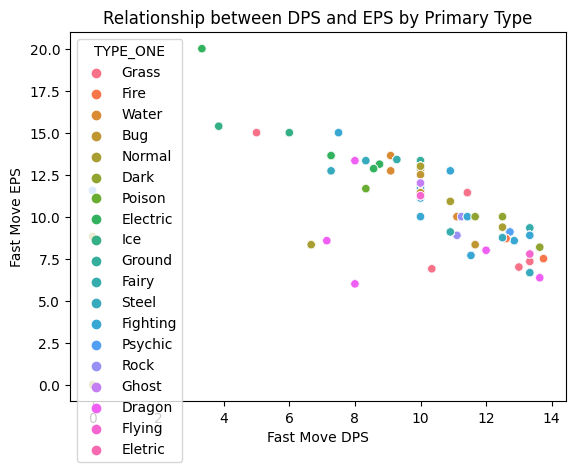

In [35]:
# Ensure plots are displayed inline in Jupyter Notebook
%matplotlib inline

import seaborn as sns
import matplotlib.pyplot as plt

# Scatter plot of DPS and EPS
sns.scatterplot(x='FAST_MOVE_DPS', y='FAST_MOVE_EPS', hue='TYPE_ONE', data=main)
plt.title('Relationship between DPS and EPS by Primary Type')
plt.xlabel('Fast Move DPS')
plt.ylabel('Fast Move EPS')
plt.show()

In [36]:
levels = pd.read_csv('../datasets/levels.csv')

In [37]:
levels

,LEVEL,CPM
0,1.0,0.094000
1,1.5,0.135137
2,2.0,0.166398
3,2.5,0.192651
4,3.0,0.215732
...,...,...
95,48.5,0.832803
96,49.0,0.835300
97,49.5,0.837803
98,50.0,0.840300


## ANALYZE MAIN DATASET WITH FEATURES

In [38]:
main_report = ProfileReport(main, title="Analyze Main")

In [39]:
main_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## FEATURES EXPLANATION

**FAST_MOVE_DPS:** 

Damage per second a fast move does. 

Calculated by Fast Move Power / Fast Move Duration

**CHARGE_MOVE_DPS:** 

Damage per second a charge move does. 

Calculated by Charge Move Power / Charge Move Duration

**FAST_MOVE_EPS:** 

How much energy per second a fast move generates. 

Calculated by Fast Energy Boost / Fast Move Duration

**SYNERGY_SCORE:** 

How well a fast move sets up a charge move, higher the score the fast energy is built up. 

Calculated by (Fast Move EPS * Charge Move Energy Cost) / Charge Move Power

**TYPE_ALIGNMENT_FAST:** 

A binary feature indicating whether the move's type aligns with the Pokémon's type, which affects the Same Type Attack Bonus (STAB).

Calculated IF TYPE_ONE or TYPE_TWO is equal to FAST_MOVE_TYPE


**TYPE_ALIGNMENT_CHARGE	:**

A binary feature indicating whether the move's type aligns with the Pokémon's type, which affects the Same Type Attack Bonus (STAB).

Calculated IF TYPE_ONE or TYPE_TWO is equal to CHARGE_MOVE_TYPE

**ADJUSTED_FAST_MOVE_DPS:**	

An adjusted fast move damage per second if a pokemon is benefiting from Same Type Attack Bonus (STAB) which is 1.2 or +20%.

Calculated by Fast Move DPS * (IF TYPE_ALIGNMENT_FAST TRUE THEN multiply by stab_bonus OTHER WISE multiply by 1 which will leave the same)


**ADJUSTED_CHARGE_MOVE_DPS:**

An adjusted charge move damage per second if a pokemon is benefiting from Same Type Attack Bonus (STAB) which is 1.2 or +20%.

Calculated by Charge Move DPS * (IF TYPE_ALIGNMENT_CHARGE TRUE THEN multiply by stab_bonus OTHER WISE multiply by 1 which will leave the same)


In [40]:
main.head()

,ID,NAME,TYPE_ONE,TYPE_TWO,FAST_MOVE,FAST_MOVE_POWER,FAST_MOVE_TYPE,FAST_ENERGY_BOOST,FAST_MOVE_DURATION,CHARGE_MOVE,...,BASE_DEFENSE,BASE_HP,FAST_MOVE_DPS,CHARGE_MOVE_DPS,FAST_MOVE_EPS,SYNERGY_SCORE,TYPE_ALIGNMENT_FAST,TYPE_ALIGNMENT_CHARGE,ADJUSTED_FAST_MOVE_DPS,ADJUSTED_CHARGE_MOVE_DPS
0,1,Bulbasaur,Grass,Poison,Tackle,5.0,Normal,5.0,0.5,Return,...,111.0,128.0,10.000000,50.000000,10.0,9.428571,False,False,10.0,50.000000
1,1,Bulbasaur,Grass,Poison,Tackle,5.0,Normal,5.0,0.5,Return,...,88.8,128.0,10.000000,50.000000,10.0,9.428571,False,False,10.0,50.000000
2,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Power Whip,...,111.0,128.0,11.666667,34.615385,10.0,5.555556,True,True,14.0,41.538462
3,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Power Whip,...,88.8,128.0,11.666667,34.615385,10.0,5.555556,True,True,14.0,41.538462
4,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Sludge Bomb,...,111.0,128.0,11.666667,34.782609,10.0,6.250000,True,True,14.0,41.739130


In [47]:
type_effectiveness = {
    'Normal': {'Rock': 0.5, 'Ghost': 0.0, 'Steel': 0.5},
    'Fire': {'Fire': 0.5, 'Water': 0.5, 'Grass': 2.0, 'Ice': 2.0, 'Bug': 2.0, 'Rock': 0.5, 'Dragon': 0.5, 'Steel': 2.0},
    'Water': {'Fire': 2.0, 'Water': 0.5, 'Grass': 0.5, 'Ground': 2.0, 'Rock': 2.0, 'Dragon': 0.5},
    'Electric': {'Water': 2.0, 'Electric': 0.5, 'Grass': 0.5, 'Ground': 0.0, 'Flying': 2.0, 'Dragon': 0.5},
    'Grass': {'Fire': 0.5, 'Water': 2.0, 'Grass': 0.5, 'Poison': 0.5, 'Ground': 2.0, 'Flying': 0.5, 'Bug': 0.5, 'Rock': 2.0, 'Dragon': 0.5, 'Steel': 0.5},
    'Ice': {'Fire': 0.5, 'Water': 0.5, 'Grass': 2.0, 'Ice': 0.5, 'Ground': 2.0, 'Flying': 2.0, 'Dragon': 2.0, 'Steel': 0.5},
    'Fighting': {'Normal': 2.0, 'Ice': 2.0, 'Poison': 0.5, 'Flying': 0.5, 'Psychic': 0.5, 'Bug': 0.5, 'Rock': 2.0, 'Ghost': 0.0, 'Dark': 2.0, 'Steel': 2.0, 'Fairy': 0.5},
    'Poison': {'Grass': 2.0, 'Poison': 0.5, 'Ground': 0.5, 'Rock': 0.5, 'Ghost': 0.5, 'Steel': 0.0, 'Fairy': 2.0},
    'Ground': {'Fire': 2.0, 'Electric': 2.0, 'Grass': 0.5, 'Poison': 2.0, 'Flying': 0.0, 'Bug': 0.5, 'Rock': 2.0, 'Steel': 2.0},
    'Flying': {'Electric': 0.5, 'Grass': 2.0, 'Fighting': 2.0, 'Bug': 2.0, 'Rock': 0.5, 'Steel': 0.5},
    'Psychic': {'Fighting': 2.0, 'Poison': 2.0, 'Psychic': 0.5, 'Dark': 0.0, 'Steel': 0.5},
    'Bug': {'Fire': 0.5, 'Grass': 2.0, 'Fighting': 0.5, 'Poison': 0.5, 'Flying': 0.5, 'Psychic': 2.0, 'Ghost': 0.5, 'Dark': 2.0, 'Steel': 0.5, 'Fairy': 0.5},
    'Rock': {'Fire': 2.0, 'Ice': 2.0, 'Fighting': 0.5, 'Ground': 0.5, 'Flying': 2.0, 'Bug': 2.0, 'Steel': 0.5},
    'Ghost': {'Normal': 0.0, 'Psychic': 2.0, 'Ghost': 2.0, 'Dark': 0.5},
    'Dragon': {'Dragon': 2.0, 'Steel': 0.5, 'Fairy': 0.0},
    'Dark': {'Fighting': 0.5, 'Psychic': 2.0, 'Ghost': 2.0, 'Dark': 0.5, 'Fairy': 0.5},
    'Steel': {'Fire': 0.5, 'Water': 0.5, 'Electric': 0.5, 'Ice': 2.0, 'Rock': 2.0, 'Steel': 0.5, 'Fairy': 2.0},
    'Fairy': {'Fire': 0.5, 'Fighting': 2.0, 'Poison': 0.5, 'Dragon': 2.0, 'Dark': 2.0, 'Steel': 0.5}
}

In [48]:
def calculate_effectiveness(row, type_effectiveness):
    fast_effectiveness = np.mean([type_effectiveness[row['FAST_MOVE_TYPE']].get(t, 1) for t in [row['TYPE_ONE'], row['TYPE_TWO']] if t])
    charge_effectiveness = np.mean([type_effectiveness[row['CHARGED_MOVE_TYPE']].get(t, 1) for t in [row['TYPE_ONE'], row['TYPE_TWO']] if t])
    return fast_effectiveness, charge_effectiveness

# Apply effectiveness calculation
main['FAST_MOVE_EFFECTIVENESS'], main['CHARGE_MOVE_EFFECTIVENESS'] = zip(*main.apply(calculate_effectiveness, args=(type_effectiveness,), axis=1))

/var/folders/j9/7txjkxjn6zs87g_3bm9f81fr0000gn/T/ipykernel_25242/3468223546.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  main['FAST_MOVE_EFFECTIVENESS'], main['CHARGE_MOVE_EFFECTIVENESS'] = zip(*main.apply(calculate_effectiveness, args=(type_effectiveness,), axis=1))
/var/folders/j9/7txjkxjn6zs87g_3bm9f81fr0000gn/T/ipykernel_25242/3468223546.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  main['FAST_MOVE_EFFECTIVENESS'], main['CHARGE_MOVE_EFFECTIVENESS'] = zip(*main.apply(calculate_effectiveness,

In [49]:
main.columns

Index(['ID', 'NAME', 'TYPE_ONE', 'TYPE_TWO', 'FAST_MOVE', 'FAST_MOVE_POWER',
       'FAST_MOVE_TYPE', 'FAST_ENERGY_BOOST', 'FAST_MOVE_DURATION',
       'CHARGE_MOVE', 'CHARGE_MOVE_POWER', 'CHARGED_MOVE_TYPE',
       'CHARGE_MOVE_ENERGY_COST', 'CHARGE_MOVE_DURATION',
       'DAMAGE WINDOW START', 'BASE_ATTACK', 'BASE_DEFENSE', 'BASE_HP',
       'FAST_MOVE_DPS', 'CHARGE_MOVE_DPS', 'FAST_MOVE_EPS', 'SYNERGY_SCORE',
       'TYPE_ALIGNMENT_FAST', 'TYPE_ALIGNMENT_CHARGE',
       'ADJUSTED_FAST_MOVE_DPS', 'ADJUSTED_CHARGE_MOVE_DPS',
       'FAST_MOVE_EFFECTIVENESS', 'CHARGE_MOVE_EFFECTIVENESS'],
      dtype='object')

In [45]:
print("Unique FAST_MOVE_TYPE:", main['FAST_MOVE_TYPE'].unique())
print("Unique CHARGED_MOVE_TYPE:", main['CHARGED_MOVE_TYPE'].unique())

Unique FAST_MOVE_TYPE: ['Normal' 'Grass' 'Fire' 'Flying' 'Dragon' 'Water' 'Dark' 'Bug' 'Psychic'
 'Poison' 'Steel' 'Electric' 'Fairy' 'Ice' 'Ground' 'Ghost' 'Fighting'
 'Rock']
Unique CHARGED_MOVE_TYPE: ['Normal' 'Grass' 'Poison' 'Fire' 'Dragon' 'Water' 'Ice' 'Steel' 'Bug'
 'Psychic' 'Flying' 'Ground' 'Ghost' 'Dark' 'Electric' 'Fairy' 'Fighting'
 'Rock' 'Steal']


In [46]:
# Correcting type names
type_corrections = {'Steal': 'Steel'}

# Apply corrections
main['FAST_MOVE_TYPE'] = main['FAST_MOVE_TYPE'].replace(type_corrections)
main['CHARGED_MOVE_TYPE'] = main['CHARGED_MOVE_TYPE'].replace(type_corrections)

/var/folders/j9/7txjkxjn6zs87g_3bm9f81fr0000gn/T/ipykernel_25242/1536494395.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  main['FAST_MOVE_TYPE'] = main['FAST_MOVE_TYPE'].replace(type_corrections)
/var/folders/j9/7txjkxjn6zs87g_3bm9f81fr0000gn/T/ipykernel_25242/1536494395.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  main['CHARGED_MOVE_TYPE'] = main['CHARGED_MOVE_TYPE'].replace(type_corrections)


In [50]:
main.head()

,ID,NAME,TYPE_ONE,TYPE_TWO,FAST_MOVE,FAST_MOVE_POWER,FAST_MOVE_TYPE,FAST_ENERGY_BOOST,FAST_MOVE_DURATION,CHARGE_MOVE,...,FAST_MOVE_DPS,CHARGE_MOVE_DPS,FAST_MOVE_EPS,SYNERGY_SCORE,TYPE_ALIGNMENT_FAST,TYPE_ALIGNMENT_CHARGE,ADJUSTED_FAST_MOVE_DPS,ADJUSTED_CHARGE_MOVE_DPS,FAST_MOVE_EFFECTIVENESS,CHARGE_MOVE_EFFECTIVENESS
0,1,Bulbasaur,Grass,Poison,Tackle,5.0,Normal,5.0,0.5,Return,...,10.000000,50.000000,10.0,9.428571,False,False,10.0,50.000000,1.0,1.00
1,1,Bulbasaur,Grass,Poison,Tackle,5.0,Normal,5.0,0.5,Return,...,10.000000,50.000000,10.0,9.428571,False,False,10.0,50.000000,1.0,1.00
2,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Power Whip,...,11.666667,34.615385,10.0,5.555556,True,True,14.0,41.538462,0.5,0.50
3,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Power Whip,...,11.666667,34.615385,10.0,5.555556,True,True,14.0,41.538462,0.5,0.50
4,1,Bulbasaur,Grass,Poison,Vine Whip,7.0,Grass,6.0,0.6,Sludge Bomb,...,11.666667,34.782609,10.0,6.250000,True,True,14.0,41.739130,0.5,1.25


In [51]:
!ls

analyze.ipynb     final_pokedex.csv final_pvp.csv


In [52]:
!mkdir feature_exploration

In [53]:
main.to_csv('feature_exploration/current_dataset_20240421.csv')